# Workshop UL01: Unsupervised Learning

## Agenda:
- Introduction to unsupervised learning
- Discussion of unsupervised methodologies (ML) 
- Deliberation of udnsupervised methodologies (DL) (Most Important)


## Motivation: 
Many real world applications of ML would require the analysis of the data to obtain pragmatic insights. Some exemplars include  

- Studying DNA for causes of disorders 
- Spectral analysis for distinguishing anstronomical objects
- Image reconstruction
- Hyperspectral satelite image analysis etc. 

As we talk about RNN we will see how unsupervised learning methodologies meets these requirements. 


In most of your bachelors and masters courses heavy emphasis was laid on supervised learning which includes attempting to predict a target variable given input variables i.e predicting stock prices or temperature based on historical data. 

It should be reminded that through out this workshop I am tasked with acquainting the users on the advantages of unsupervised learning, than to censure nor create an expose on supervised learning. 


## Types of Unsupervised Learning:

|Unsupervised Machine Learning|Unsupervised Deep Learning|
|:--:|:---:|
|Isolation Forest| Autoencoders (Vanilla, Denoising, Sparse)| 
|K-Means Clustering| Restricted Boltzmann Machine | 
|Local Outlier Factor| Variational Autoencoder| 

Brief discussion of the Machine-Learning Unsupervised models would include, while emphasis being laid on Autoencoders and Restricted Boltzman MAchines. 

## Unsupervised Machine Learning 

### 1) Isolation Forest 

It is a variant of random forest, where by outliers are detected based on the number of splits required for classification. 

https://towardsdatascience.com/outlier-detection-with-isolation-forest-3d190448d45e

### 2) K-means clustering 

Particular clustering methodology of such would be the \textit{K-means} clustering. K-means clustering attempts to partition the data into $k$ groups $(C_{1}, \ldots, C_{K})$, it begins by choosing $K$ initial cluster centres and then iteratively refine them (wagstaff2001constrained). The idea behind \textit{K-means} clustering is to reduce with in cluster variation $W\left(C_{k}\right)$ as much as possible such that, the observations can be partitioned into $K$ clusters with minimum with in cluster variation summed over all K clusters. In essence   $\operatorname{minimize}\left\{\sum_{k=1}^{K} W\left(C_{k}\right)\right\}$ w.r.t  $C_{1}, \ldots, C_{K}$. The objective function; with in cluster variation  $(W(C_{k}))$ is defined typically in terms of Hamming distance or the squared Euclidian distance. 


### 3) Local Outlier Factor
Find more information at the following paper. Highly recommended. If you require the code consult chamal gomes. 

http://people.cs.vt.edu/badityap/classes/cs6604-Fall13/readings/breunig-2000.pdf



# Unsupervised Machine Learning 

## 1) Vanilla Autoencoders

Autoencoders are simple learning circuits which are tasked with transforming in- puts into outputs, whilst having least possible amount of distortion. It consists of an encoder function f and a decoder function g. Aim of the encoder function f , is to compress the input to a lower representation using the most salient features of the input data. In turn the aim of the decoder function g is to then reconstruct the input form the compressed features. Thus, the whole functionality of an Autoen- coder, for input data x can be presented as follows, where g( f (x)) = r(x) denotes the reconstructed input. 

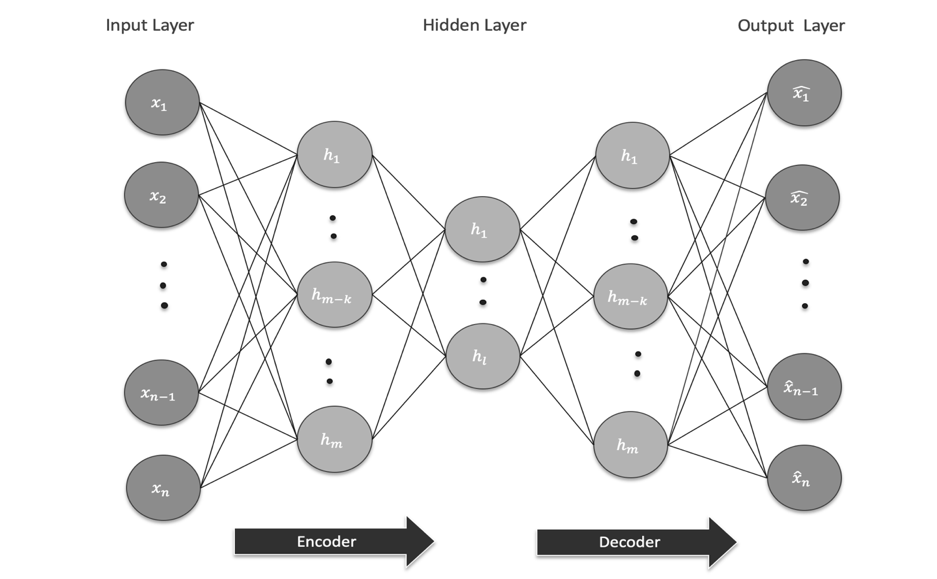

image source https://chamalgomes.ml

The objective function of the vanilla Autoencoders could then be depicted as minimising the reconstruction error during the training process, which is quite intuitive.  

\begin{aligned} J\left(W, b\right)
&= \min \|\mathrm{x}-\mathrm{g}(\mathrm{f}(\mathrm{x}))\|_{2}
&=\sum_{i=1}^{n}\left(\tilde{x}^{[i]}-x^{[i]}\right)^{2} . 
\end{aligned}

Where W_{1}, b_{1}, W_{2}, b_{2},W_{3}, b_{3}, W_{4}, b_{4} are the respective weights and bias for each of the hidden layers of the Autoencoder. One could chose their own loss function aprrt from the MSE which I have used. 


## 2) Denoising Autoencoders

Denosing Autoencoders receive corrupted input data, and the goal is set to create the original (uncorrupted input) from the corrupted input. In computer vision applications the corruption process usually takes place in the form of forcing random feture points being equaled to zero.  Can anyone guess possible applications of Denoising Autoencdoes ? 


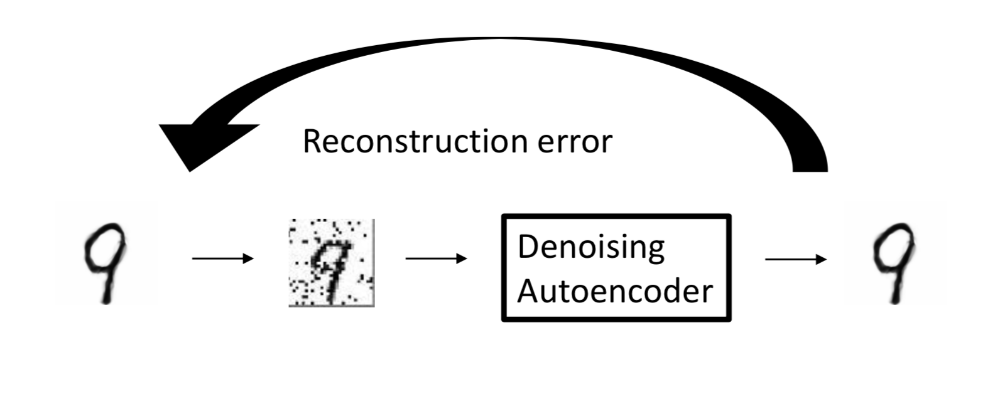

image source https://github.com/mounikachandra/DenoisingAutoEncoders-StackedEncoders/issues/1

#### Noise in Python 

In [34]:
def masking_noise(X, v):
    """ Apply masking noise to data in X, in other words a fraction v of elements of X
    (chosen at random) is forced to zero."""
    
    X_noise = X.copy()

    n_samples = X.shape[0]
    n_features = X.shape[1]

    for i in range(n_samples):
        mask = np.random.choice(range(n_features), int(v*n_features), replace=False)
        for m in mask:
            X_noise[i][m] = 0.
    return X_noise

## 3) Sparse Autoencoders

A sparse autoencoder is simply an autoencoder whose training criterion involves a sparsity penalty Ω(h) on the code layer h, in addition to the reconstruction error. An autoencoder that has been regularized to be sparse must respond to unique statistical features of the dataset it has been trained on, rather than simply acting as an identity function. In this way, training to perform the copying task with a sparsity penalty can yield a model that has learned useful features as a byproduct.

\begin{aligned}J_{\text {sparse }}(W, b)=J(W, b)+\beta \sum_{j=1}^{s_{2}} \mathrm{KL}\left(\rho \| \hat{\rho}_{j}\right)\end{aligned}

where $\beta$ controls the weight of the sparsity parameter. KL refers to Kullback Leibler divergencs,KL-divergence is a standard function for
measuring how different two different distributions are. What does the penalty function (KL term) really do ? 

\begin{aligned} \mathrm{KL}\left(\rho \| \hat{\rho}_{j}\right) = \sum_{j=1}^{D} \rho \log \frac{\rho}{\hat{\rho}_{j}}+(1-\rho) \log \frac{1-\rho}{1-\hat{\rho}_{j}}\end{aligned}

\begin{aligned} \hat{\rho}_{j}=\frac{1}{m} \sum_{i=1}^{m}\left[a_{j}^{(2)}\left(x^{(i)}\right)\right] \end{aligned}


Where, $\rho$ is the sparsity parameter, typically a small value close to zero (say
ρ = 0.05). In other words, we would like the average activation of each
hidden neuron j to be close to 0.05 (say). To satisfy this constraint, the
hidden unit’s activations must mostly be near 0. D refers to the number of hidden neurons in the hidden layer. 
What sort of activation function should we use based on the above equations ? 

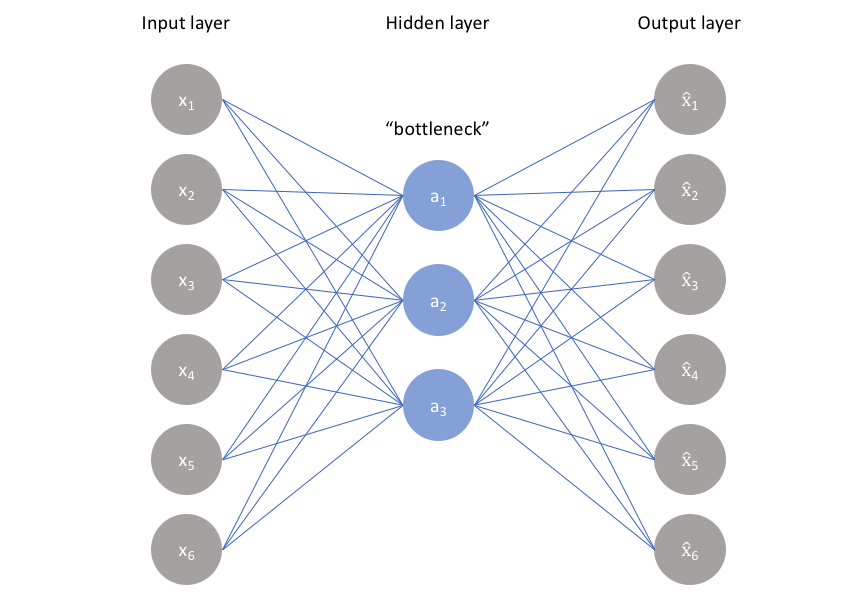

image source https://www.jeremyjordan.me/autoencoders/


# Vanilla Autoencoder in Keras

In [1]:
import pandas as pd
import numpy as np
import tensorflow as tf 
import os
import seaborn as sns

from datetime import datetime 
from tqdm import tqdm 

from sklearn.metrics import roc_auc_score as auc 
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (confusion_matrix, precision_recall_curve, auc,
                             roc_curve, recall_score, classification_report, f1_score,
                             precision_recall_fscore_support)
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline

import plotly 

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

#import plotly.plotly as py
import plotly.graph_objs as go
import plotly.figure_factory as ff

#Keras Packages  
from keras.layers import Input, Dense, Lambda 
from keras import backend as K 
from keras import objectives 
from scipy.stats import norm 
from keras.utils import plot_model
from keras.callbacks import ModelCheckpoint, TensorBoard
from keras import regularizers
from keras.models import Model, load_model

Using TensorFlow backend.


### Importing the Data 

In [2]:
# Set ipython's max row display
pd.set_option('display.expand_frame_repr', True)
data = pd.read_csv("/Users/chamalgomes/Documents/Machine_Learning/Data Sets/Credit Card data/creditcard.csv")
df = pd.DataFrame(data)
#df = df.drop('Time',axis = 1)
colnames = list(df.head(0))

#df.sort_values('Time', inplace = True)
df = df.drop('Time',axis = 1)
#df = df.drop('Amount',axis = 1)
df['Amount'] = StandardScaler().fit_transform(df['Amount'].values.reshape(-1, 1))
#print(df.shape())
df.head()
#df.dtypes

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,0.244964,0
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,-0.342475,0
2,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,1.160686,0
3,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,0.140534,0
4,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,-0.073403,0


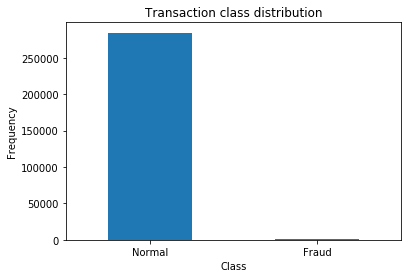

In [3]:
#plot of the Class counts 
LABELS = ["Normal", "Fraud"]
count_classes = pd.value_counts(df['Class'], sort = True)
count_classes.plot(kind = 'bar', rot=0)
plt.title("Transaction class distribution")
plt.xticks(range(2), LABELS)
plt.xlabel("Class")
plt.ylabel("Frequency");

### Data Split 

In [4]:
train_x, test_x = train_test_split(df, test_size=0.2, random_state = 45)
#train_x = train_x[train_x.Class == 0]
train_x = train_x.drop(['Class'], axis=1)

test_y = test_x['Class']
test_x = test_x.drop(['Class'], axis=1)

train_x = train_x.values
test_x = test_x.values

print(train_x.shape)
print(test_x.shape)
print(df.shape)

(227845, 29)
(56962, 29)
(284807, 30)


In [5]:
#print("Total train examples: {}, total fraud cases: {}, equal to {:.5f} of total cases. ".format(train_x.shape[0], np.sum(train_y), np.sum(train_y)/train_x.shape[0]))

In [6]:
print("Total test examples: {}, total fraud cases: {}, equal to {:.5f} of total cases. ".format(test_x.shape[0], np.sum(test_y), np.sum(test_y)/test_y.shape[0]))

Total test examples: 56962, total fraud cases: 115, equal to 0.00202 of total cases. 


### Normalising the Data 

In [7]:
need_Normalizing = "Tre" # no Normalizing needed for this since allready PCA form 
activation_type = "tanh"

if need_Normalizing=="True":
    if activation_type == "sigmoid":
        cols_max = []
        cols_min = []
        for c in range(train_x.shape[1]):
            cols_max.append(train_x[:,c].max())
            cols_min.append(train_x[:,c].min())
            train_x[:, c] = (train_x[:, c] - cols_min[-1]) / (cols_max[-1] - cols_min[-1])
            test_x[:, c] =  (test_x[:, c] - cols_min[-1]) / (cols_max[-1] - cols_min[-1])
        print("sigmoid type normalisation done")

    else:
        cols_mean = []
        cols_std = []
        for c in range(train_x.shape[1]):
            cols_mean.append(train_x[:,c].mean())
            cols_std.append(train_x[:,c].std())
            train_x[:, c] = (train_x[:, c] - cols_mean[-1]) / cols_std[-1]
            test_x[:, c] =  (test_x[:, c] - cols_mean[-1]) / cols_std[-1]
        print("tanh type normalisation done")
else:
    print("No Normalizing done")

No Normalizing done


### Model Architecture and Training 

In [8]:
input_dim = train_x.shape[1]
encoding_dim = 14

input_layer = Input(shape=(input_dim, ))
encoder = Dense(encoding_dim, activation="tanh", activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)
autoencoder = Model(inputs=input_layer, outputs=decoder)

W0925 13:04:25.090426 4707878336 deprecation_wrapper.py:119] From /anaconda3/envs/tnsflo/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0925 13:04:25.123610 4707878336 deprecation_wrapper.py:119] From /anaconda3/envs/tnsflo/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0925 13:04:25.136873 4707878336 deprecation_wrapper.py:119] From /anaconda3/envs/tnsflo/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.



In [9]:
nb_epoch = 3
batch_size = 32
autoencoder.compile(optimizer='adam', 
                    loss='mean_squared_error', 
                    metrics=['accuracy'])

checkpointer = ModelCheckpoint(filepath="model.h5",
                               verbose=0,
                               save_best_only=True)

tensorboard = TensorBoard(log_dir='./logs',
                          histogram_freq=0,
                          write_graph=True,
                          write_images=True)

history = autoencoder.fit(train_x, train_x,
                    epochs=nb_epoch,
                    batch_size=batch_size,
                    shuffle=True,
                    validation_data=(test_x, test_x),
                    verbose=1,
                    callbacks=[checkpointer, tensorboard]).history

W0925 13:04:28.121612 4707878336 deprecation_wrapper.py:119] From /anaconda3/envs/tnsflo/lib/python3.6/site-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.

W0925 13:04:30.071444 4707878336 deprecation_wrapper.py:119] From /anaconda3/envs/tnsflo/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:986: The name tf.assign_add is deprecated. Please use tf.compat.v1.assign_add instead.

W0925 13:04:30.177781 4707878336 deprecation_wrapper.py:119] From /anaconda3/envs/tnsflo/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:973: The name tf.assign is deprecated. Please use tf.compat.v1.assign instead.

W0925 13:04:30.436410 4707878336 deprecation_wrapper.py:119] From /anaconda3/envs/tnsflo/lib/python3.6/site-packages/keras/callbacks.py:850: The name tf.summary.merge_all is deprecated. Please use tf.compat.v1.summary.merge_all instead.

W0925 13:04:30.437449 4707878336 deprecation_wrapper.

Train on 227845 samples, validate on 56962 samples
Epoch 1/3
227845/227845 [==============================] - 9s 37us/step - loss: 0.8791 - acc: 0.5497 - val_loss: 0.8039 - val_acc: 0.6219
Epoch 2/3
227845/227845 [==============================] - 8s 34us/step - loss: 0.7978 - acc: 0.6317 - val_loss: 0.7821 - val_acc: 0.6379
Epoch 3/3
227845/227845 [==============================] - 7s 32us/step - loss: 0.7871 - acc: 0.6403 - val_loss: 0.7756 - val_acc: 0.6427


In [10]:
autoencoder = load_model('model.h5')


trace1 = go.Scatter(
    x = list(range(nb_epoch)),
    y = history['loss'],
    mode = 'lines',
    name = 'Training Loss'
)

trace2 = go.Scatter(
    x = list(range(nb_epoch)),
    y = history['val_loss'],
    mode = 'lines',
    name = 'Validation Loss'
)

layout = go.Layout(title='Training VS Validation Loss',
                   xaxis=dict(title='Epochs'),
                   yaxis=dict(title='Loss'))


data = [trace1, trace2]
fig = go.Figure(data, layout=layout)
iplot(fig, filename='Loss curve')

In [11]:
predictions = autoencoder.predict(test_x)
print(type(predictions))
mse = np.mean(np.power(test_x - predictions, 2), axis=1)
error_df = pd.DataFrame({'reconstruction_error': mse,
                        'true_class': test_y})
print(error_df.shape)
error_df.head()


<class 'numpy.ndarray'>
(56962, 2)


,reconstruction_error,true_class
11783,0.728334,0
199531,1.204096,0
226972,0.244233,0
229378,0.394574,0
101019,0.887669,0


### ROC Curve

In [12]:
fpr, tpr, thresholds = roc_curve(error_df.true_class, error_df.reconstruction_error)
roc_auc = auc(fpr, tpr)

trace1 = go.Scatter(x=fpr, y=tpr, 
                    mode='lines', 
                    line=dict(color='darkorange', width=2),
                    name='ROC curve (area = %0.2f)' % roc_auc
                   )

trace2 = go.Scatter(x=[0, 1], y=[0, 1], 
                    mode='lines', 
                    line=dict(color='navy', width=2, dash='dash'),
                    showlegend=False)

layout = go.Layout(title='Receiver Operating Characteristic (ROC)',
                   xaxis=dict(title='False Positive Rate'),
                   yaxis=dict(title='True Positive Rate'))

fig = go.Figure(data=[trace1, trace2], layout=layout)
iplot(fig, filename='ROC curve')

### Reconstruction Error Analysis 

In [16]:
Non_Fraud = error_df[(error_df['true_class']== 0) & (error_df['reconstruction_error'] < 15)]
Fraud = error_df[(error_df['true_class']== 1) & (error_df['reconstruction_error'] < 15)]
Non_Fraud = Non_Fraud['reconstruction_error'].values
Fraud = Fraud['reconstruction_error'].values

In [17]:
trace1 = go.Histogram(
    x=Non_Fraud,
    name = "Non-Fraud",
    opacity=0.75,
    xbins=dict(
        start=0,
        end=15,
        size=0.2
    ),
    histnorm='probability',
    marker=dict(
        color="#20aa4e")
)
trace2 = go.Histogram(
    x=Fraud,
    name = "Fraud",
    opacity=0.75,
    xbins=dict(
        start=0,
        end=15,
        size=0.2
    ),
    histnorm='probability',
    marker=dict(
        color="#e22222")
)

data = [trace1, trace2]
layout = go.Layout(
    barmode='overlay', 
    title ="Reconstruction Error Distribution",
    xaxis=dict(
        title='Reconstruction Error'
    ),
    yaxis=dict(
        title='Frquency'
    )
    )
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='Density of reocon error')

### Precision Recall Analysis 

In [18]:
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
lw = 2


lines = []
precision, recall, th = precision_recall_curve(error_df.true_class, error_df.reconstruction_error)
average_precision = average_precision_score(error_df.true_class, error_df.reconstruction_error)

lines.append( (precision, recall, 'Precision Recall Curve') )
#plot_precision_recall(lines)

trace1 = go.Scatter(x = recall, y = precision, 
                    mode='lines',
                    line=dict(width=lw, color='navy'),
                    name='Precision-Recall curve')

layout = go.Layout(title='Precision-Recall example: AUC={0:0.2f}'.format(average_precision),
                   xaxis=dict(title='Recall'),
                   yaxis=dict(title='Precision'))

fig = go.Figure(data=[trace1], layout=layout)
iplot(fig)

In [19]:
print(recall.shape)
print(precision.shape)
print(test_y.shape)

(51054,)
(51054,)
(56962,)


In [20]:
#Graph set up 
"""
precisions = []
recalls = []
all_pos = sum(test_y)
for threshold in range(1, 150):
    all_predicted = sum(error_df['reconstruction_error'] > threshold)
    TP = sum((error_df['reconstruction_error'] > threshold) & (test_y == 1))
    precisions.append(TP  / all_predicted)
    recalls.append(TP / all_pos)
"""

"\nprecisions = []\nrecalls = []\nall_pos = sum(test_y)\nfor threshold in range(1, 150):\n    all_predicted = sum(error_df['reconstruction_error'] > threshold)\n    TP = sum((error_df['reconstruction_error'] > threshold) & (test_y == 1))\n    precisions.append(TP  / all_predicted)\n    recalls.append(TP / all_pos)\n"

In [21]:
#Recall Curve 
trace0 = go.Scatter(
    y = recall[1:],
    x = th,
    mode = 'lines',
    name = 'recall'
)
data = [trace0]
layout = dict(title = 'Recall Curve',
              xaxis = dict(title = 'Reconstruction Error',range=[0, 200]),
              yaxis = dict(title = 'Recall Rate'),
              )

fig = dict(data=data, layout=layout)
iplot(fig, filename='Recall Curve')

In [22]:
#Precision Curve 
trace0 = go.Scatter(
    y = precision[1:],
    x = th, 
    mode = 'lines',
    name = 'recall'
)
data = [trace0]
layout = dict(title = 'Precision Curve',
              xaxis = dict(title = 'Reconstruction Error',range = [0,500]),
              yaxis = dict(title = 'Precision Rate'),
              )

fig = dict(data=data, layout=layout)
iplot(fig, filename='Precision Curve')

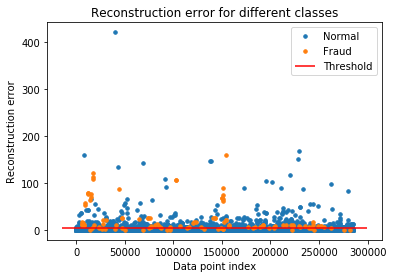

In [23]:
threshold = 4
groups = error_df.groupby('true_class')
fig, ax = plt.subplots()

for name, group in groups:
    ax.plot(group.index, group.reconstruction_error, marker='o', ms=3.5, linestyle='',
            label= "Fraud" if name == 1 else "Normal")
ax.hlines(threshold, ax.get_xlim()[0], ax.get_xlim()[1], colors="r", zorder=100, label='Threshold')
ax.legend()
plt.title("Reconstruction error for different classes")
plt.ylabel("Reconstruction error")
plt.xlabel("Data point index")
plt.show();

In [24]:
threshold = 3
y_pred = [1 if e > threshold else 0 for e in error_df.reconstruction_error.values]
conf_matrix = confusion_matrix(error_df.true_class, y_pred)

"""
plt.figure(figsize=(12, 12))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("Confusion matrix")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()
"""

from sklearn.metrics import classification_report, confusion_matrix

print (classification_report(test_y, y_pred,digits=4))
# Print confusion matrix using predictions
print(confusion_matrix(test_y, y_pred))


              precision    recall  f1-score   support

           0     0.9997    0.9774    0.9885     56847
           1     0.0723    0.8696    0.1335       115

    accuracy                         0.9772     56962
   macro avg     0.5360    0.9235    0.5610     56962
weighted avg     0.9979    0.9772    0.9867     56962

[[55564  1283]
 [   15   100]]


## 4) Restrcted Boltzmann Machines 

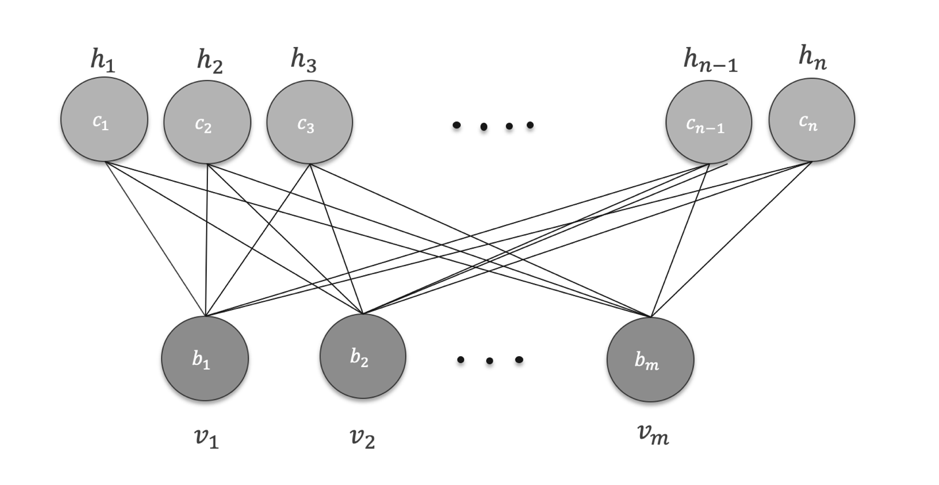

In [27]:
from rbm import RBM

model = RBM(train_x.shape[1], 10, visible_unit_type='gauss', main_dir='/Users/chamalgomes/Documents/Python/GitLab/DeepLearning/research_work/Credit card fraud data/IGBRBM/models', model_name='rbm_model.ckpt',
                 gibbs_sampling_steps=4, learning_rate=0.001, momentum = 0.95, batch_size=512, num_epochs=50, verbose=1)


W0925 13:18:10.295636 4707878336 deprecation_wrapper.py:119] From /Users/chamalgomes/Documents/Python/GitHub/MLSA/MLSA-workshops-2019/Unsupervised-Learning/rbm.py:133: The name tf.train.Saver is deprecated. Please use tf.compat.v1.train.Saver instead.



Validation cost at step 0: 0.9126993
Validation cost at step 1: 0.8646403
Validation cost at step 2: 0.84423554
Validation cost at step 3: 0.83680314
Validation cost at step 4: 0.8345429
Validation cost at step 5: 0.83423275
Validation cost at step 6: 0.83141094
Validation cost at step 7: 0.83374697
Validation cost at step 8: 0.8319521
Validation cost at step 9: 0.83084095
Validation cost at step 10: 0.83107513
Validation cost at step 11: 0.8305605
Validation cost at step 12: 0.83143955
Validation cost at step 13: 0.8288584
Validation cost at step 14: 0.8279208
Validation cost at step 15: 0.8294214
Validation cost at step 16: 0.82703364
Validation cost at step 17: 0.8322617
Validation cost at step 18: 0.826995
Validation cost at step 19: 0.829306
Validation cost at step 20: 0.82757574
Validation cost at step 21: 0.8270226
Validation cost at step 22: 0.8297217
Validation cost at step 23: 0.8246119
Validation cost at step 24: 0.82626456
Validation cost at step 25: 0.8240402
Validation co

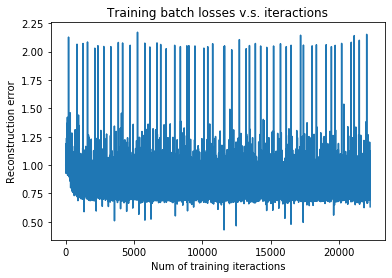

In [28]:
model.fit(train_x, validation_set=test_x)

In [29]:
test_cost = model.getFreeEnergy(test_x).reshape(-1)

mse = model.getFreeEnergy(test_x).reshape(-1)
error_df = pd.DataFrame({'free_energy': mse,
                        'true_class': test_y})
print(error_df.shape)
error_df.head()

W0925 13:18:55.036447 4707878336 deprecation.py:323] From /anaconda3/envs/tnsflo/lib/python3.6/site-packages/tensorflow/python/training/saver.py:1276: checkpoint_exists (from tensorflow.python.training.checkpoint_management) is deprecated and will be removed in a future version.
Instructions for updating:
Use standard file APIs to check for files with this prefix.


(56962, 2)


,free_energy,true_class
11783,-1.221718,0
199531,7.792535,0
226972,-5.829277,0
229378,-3.783661,0
101019,-1.705519,0


In [30]:
fpr, tpr, _ = roc_curve(test_y, test_cost)
roc_auc = auc(fpr, tpr)
lw = 2

trace1 = go.Scatter(x=fpr, y=tpr, 
                    mode='lines', 
                    line=dict(color='darkorange', width=lw),
                    name='ROC curve (area = %0.2f)' % roc_auc
                   )

trace2 = go.Scatter(x=[0, 1], y=[0, 1], 
                    mode='lines', 
                    line=dict(color='navy', width=lw, dash='dash'),
                    showlegend=False)

layout = go.Layout(title='Receiver Operating Characteristic (ROC)',
                   xaxis=dict(title='False Positive Rate'),
                   yaxis=dict(title='True Positive Rate'))

fig = go.Figure(data=[trace1, trace2], layout=layout)
iplot(fig, filename='ROC curve')
#world_readable= True

In [32]:
Non_Fraud = test_cost[(test_y == 0) & (test_cost < 400)] 
Fraud = test_cost[(test_y == 1) & (test_cost < 400)]  

trace1 = go.Histogram(
    x=Non_Fraud,
    name = "Non-Fraud",
    opacity=0.75,
    xbins=dict(
        start=-5.0,
        end=400,
        size=10
    ),
    histnorm='probability',
    marker=dict(
        color="#20aa4e")
)
trace2 = go.Histogram(
    x=Fraud,
    name = "Fraud",
    opacity=0.75,
    xbins=dict(
        start=-5.0,
        end=400,
        size=10
    ),
    histnorm='probability',
    marker=dict(
        color="#e22222")
)

data = [trace1, trace2]
layout = go.Layout(
    barmode='overlay', 
    title ="Free Energy Distribution",
    xaxis=dict(
        title='Free-Energy'
    ),
    yaxis=dict(
        title='Frquency'
    )
    )

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='Density of Free Energy')

In [33]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
LABELS = ["Normal", "Fraud"]

threshold = 10
y_pred = [1 if e > threshold else 0 for e in error_df.free_energy.values]
conf_matrix = confusion_matrix(error_df.true_class, y_pred)

"""
plt.figure(figsize=(12, 12))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("Confusion matrix")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()
"""


from sklearn.metrics import classification_report, confusion_matrix

print (classification_report(test_y, y_pred,digits=4))
# Print confusion matrix using predictions
print(confusion_matrix(test_y, y_pred))

              precision    recall  f1-score   support

           0     0.9998    0.9529    0.9758     56847
           1     0.0367    0.8870    0.0705       115

    accuracy                         0.9528     56962
   macro avg     0.5182    0.9199    0.5231     56962
weighted avg     0.9978    0.9528    0.9739     56962

[[54169  2678]
 [   13   102]]
